<a href="https://colab.research.google.com/github/Deepanshu41008/Gargantua-A-Relativistic-MCMC-Rendering-Engine/blob/main/black_hole_using_mlt.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%%writefile blackhole_engine.cpp
#include <iostream>
#include <fstream>
#include <vector>
#include <cmath>
#include <random>
#include <iomanip>
#include <sstream>
#include <string>
#include <omp.h>
#include <algorithm>

const double PI = 3.14159265358979323846;
const double M = 1.0;
const double EventHorizon = 2.0 * M;
struct Vec3 {
    double x, y, z;
    Vec3() : x(0), y(0), z(0) {}
    Vec3(double x, double y, double z) : x(x), y(y), z(z) {}
    Vec3 operator+(const Vec3& v) const { return Vec3(x+v.x, y+v.y, z+v.z); }
    Vec3 operator-(const Vec3& v) const { return Vec3(x-v.x, y-v.y, z-v.z); }
    Vec3 operator*(double d) const { return Vec3(x*d, y*d, z*d); }
    Vec3 cross(const Vec3& v) const { return Vec3(y*v.z - z*v.y, z*v.x - x*v.z, x*v.y - y*v.x); }
    double dot(const Vec3& v) const { return x*v.x + y*v.y + z*v.z; }
    double length() const { return std::sqrt(dot(*this)); }
    Vec3 normalize() const { double l = length(); return Vec3(x/l, y/l, z/l); }
};

Vec3 gravity_acceleration(const Vec3& pos, const Vec3& vel) {
    double r = pos.length();
    if (r < EventHorizon) return Vec3(0,0,0);
    Vec3 h = pos.cross(vel);
    double h2 = h.dot(h);
    double r5 = std::pow(r, 5);
    return pos * (-3.0 * M * h2 / r5);
}

void rk4_step(Vec3& pos, Vec3& vel, double dt) {
    Vec3 k1_v = gravity_acceleration(pos, vel);
    Vec3 k1_p = vel;
    Vec3 k2_v = gravity_acceleration(pos + k1_p * (dt/2.0), vel + k1_v * (dt/2.0));
    Vec3 k2_p = vel + k1_v * (dt/2.0);
    Vec3 k3_v = gravity_acceleration(pos + k2_p * (dt/2.0), vel + k2_v * (dt/2.0));
    Vec3 k3_p = vel + k2_v * (dt/2.0);
    Vec3 k4_v = gravity_acceleration(pos + k3_p * dt, vel + k3_v * dt);
    Vec3 k4_p = vel + k3_v * dt;

    pos = pos + (k1_p + k2_p * 2.0 + k3_p * 2.0 + k4_p) * (dt / 6.0);
    vel = vel + (k1_v + k2_v * 2.0 + k3_v * 2.0 + k4_v) * (dt / 6.0);
}
double trace_photon(double u, double v, int width, int height, Vec3 cam_pos, Vec3 forward) {
    double screen_x = (2.0 * u - 1.0) * ((double)width/height);
    double screen_y = (2.0 * v - 1.0);
    Vec3 right = Vec3(0.0, 1.0, 0.0).cross(forward).normalize();
    Vec3 up = right.cross(forward).normalize();
    double fov_scale = 0.35;
    Vec3 ray_dir = (forward + right * (screen_x * fov_scale) + up * (screen_y * fov_scale)).normalize();

    Vec3 pos = cam_pos;
    Vec3 vel = ray_dir;

    for (int step = 0; step < 2000; ++step) {
        Vec3 old_pos = pos;
        double r = pos.length();

        double dt = std::max(0.01, 0.08 * (r / 20.0));
        rk4_step(pos, vel, dt);
        r = pos.length();

        if (r <= EventHorizon) return 0.0;

        if ((old_pos.y > 0.0 && pos.y <= 0.0) || (old_pos.y < 0.0 && pos.y >= 0.0)) {
            if (r > 2.6 * M && r < 14.0 * M) {
                double intensity = 15.0 / (r * r);
                double doppler_shift = 1.0 - 0.6 * (pos.x / r);
                intensity *= std::pow(doppler_shift, 3.0);
                return intensity;
            }
        }
        if (r > 35.0) break;
    }
    return 0.0;
}

void save_frame(const std::vector<double>& image, int width, int height, const std::string& filename) {
    std::ofstream file(filename);
    file << "P3\n" << width << " " << height << "\n255\n";
    double max_val = 0.0;
    for (double v : image) if (v > max_val) max_val = v;
    if (max_val == 0.0) max_val = 1.0;
    for (int y = height - 1; y >= 0; --y) {
        for (int x = 0; x < width; ++x) {
            double val = image[y * width + x] / (max_val * 0.08);
            val = std::min(1.0, std::max(0.0, val));
            val = std::pow(val, 1.0/2.2);
            int r = std::min(255, (int)(val * 255.0));
            int g = std::min(255, (int)(val * 190.0));
            int b = std::min(255, (int)(val * 90.0));
            file << r << " " << g << " " << b << "\n";
        }
    }
    file.close();
}

void render_scene(int width, int height, int total_iters, Vec3 cam_pos, Vec3 forward, const std::string& filename) {
    std::vector<double> final_image(width * height, 0.0);
    int threads = omp_get_max_threads();
    int iters_per_thread = total_iters / threads;

    #pragma omp parallel for
    for (int th = 0; th < threads; ++th) {
        std::mt19937 rng(42 + th);
        std::uniform_real_distribution<double> uni(0.0, 1.0);
        std::normal_distribution<double> norm(0.0, 0.005);
        std::vector<double> local_image(width * height, 0.0);

        double u_curr, v_curr, I_curr;
        do {
            u_curr = uni(rng); v_curr = uni(rng);
            I_curr = trace_photon(u_curr, v_curr, width, height, cam_pos, forward);
        } while (I_curr == 0.0);

        for (int i = 0; i < iters_per_thread; ++i) {
            double u_prop, v_prop;
            if (uni(rng) < 0.05) { u_prop = uni(rng); v_prop = uni(rng); }
            else { u_prop = std::fmod(u_curr + norm(rng) + 1.0, 1.0); v_prop = std::fmod(v_curr + norm(rng) + 1.0, 1.0); }

            double I_prop = trace_photon(u_prop, v_prop, width, height, cam_pos, forward);
            if (uni(rng) < ((I_curr == 0.0) ? 1.0 : std::min(1.0, I_prop / I_curr))) {
                u_curr = u_prop; v_curr = v_prop; I_curr = I_prop;
            }
            int px = std::min(width - 1, std::max(0, (int)(u_curr * width)));
            int py = std::min(height - 1, std::max(0, (int)(v_curr * height)));
            local_image[py * width + px] += I_curr;
        }
        #pragma omp critical
        {
            for(int px=0; px<width*height; ++px) final_image[px] += local_image[px];
        }
    }
    save_frame(final_image, width, height, filename);
}

void render_convergence(int width, int height, int total_iters, int frames, Vec3 cam_pos, Vec3 forward, const std::string& final_name) {
    std::vector<double> final_image(width * height, 0.0);
    int threads = omp_get_max_threads();
    int iters_per_thread = total_iters / threads;
    int chunk = iters_per_thread / frames;

    struct ThreadState {
        double u_curr, v_curr, I_curr;
        std::mt19937 rng;
        std::vector<double> local_image;
    };
    std::vector<ThreadState> states(threads);

    #pragma omp parallel for
    for (int th = 0; th < threads; ++th) {
        states[th].rng = std::mt19937(42 + th);
        std::uniform_real_distribution<double> uni(0.0, 1.0);
        states[th].local_image.resize(width * height, 0.0);
        do {
            states[th].u_curr = uni(states[th].rng);
            states[th].v_curr = uni(states[th].rng);
            states[th].I_curr = trace_photon(states[th].u_curr, states[th].v_curr, width, height, cam_pos, forward);
        } while (states[th].I_curr == 0.0);
    }
    for (int f = 0; f < frames; ++f) {
        #pragma omp parallel for
        for (int th = 0; th < threads; ++th) {
            std::uniform_real_distribution<double> uni(0.0, 1.0);
            std::normal_distribution<double> norm(0.0, 0.005);

            for (int i = 0; i < chunk; ++i) {
                double u_prop, v_prop;
                if (uni(states[th].rng) < 0.05) {
                    u_prop = uni(states[th].rng); v_prop = uni(states[th].rng);
                } else {
                    u_prop = std::fmod(states[th].u_curr + norm(states[th].rng) + 1.0, 1.0);
                    v_prop = std::fmod(states[th].v_curr + norm(states[th].rng) + 1.0, 1.0);
                }

                double I_prop = trace_photon(u_prop, v_prop, width, height, cam_pos, forward);
                if (uni(states[th].rng) < ((states[th].I_curr == 0.0) ? 1.0 : std::min(1.0, I_prop / states[th].I_curr))) {
                    states[th].u_curr = u_prop; states[th].v_curr = v_prop; states[th].I_curr = I_prop;
                }
                int px = std::min(width - 1, std::max(0, (int)(states[th].u_curr * width)));
                int py = std::min(height - 1, std::max(0, (int)(states[th].v_curr * height)));
                states[th].local_image[py * width + px] += states[th].I_curr;
            }
        }
        std::fill(final_image.begin(), final_image.end(), 0.0);
        for (int th = 0; th < threads; ++th) {
            for(int px=0; px<width*height; ++px) final_image[px] += states[th].local_image[px];
        }

        std::stringstream ss;
        ss << "conv_" << std::setw(3) << std::setfill('0') << f << ".ppm";
        save_frame(final_image, width, height, ss.str());
        std::cerr << "Convergence Frame " << f + 1 << " / " << frames << "\r" << std::flush;
    }

    save_frame(final_image, width, height, final_name);
    std::cerr << "\nStatic Masterpiece Generated.\n";
}
int main(int argc, char** argv) {
    if (argc < 2) return 1;
    std::string mode = argv[1];

    double radius = 22.0;
    double base_angle = 0.0;
    double base_height = 1.0;

    if (mode == "static") {
        Vec3 cam_pos(radius * std::sin(base_angle), base_height, radius * std::cos(base_angle));
        Vec3 forward = (Vec3(0,0,0) - cam_pos).normalize();
        render_convergence(800, 800, 20000000, 40, cam_pos, forward, "static_master.ppm");
    }
    else if (mode == "anim") {
        int frames = 40;
        for (int f = 0; f < frames; ++f) {
            double t = (double)f / (frames - 1);
            double angle_deg = 90.0 * std::sin(2.0 * PI * t);
            double height = base_height + 3.0 * std::sin(2.0 * PI * t * 2.0);

            double angle_rad = angle_deg * PI / 180.0;
            Vec3 cam_pos(radius * std::sin(angle_rad), height, radius * std::cos(angle_rad));
            Vec3 forward = (Vec3(0,0,0) - cam_pos).normalize();

            std::stringstream ss;
            ss << "anim_" << std::setw(3) << std::setfill('0') << f << ".ppm";
            render_scene(500, 500, 1500000, cam_pos, forward, ss.str());
            std::cerr << "Rendered HD Animation Frame " << f + 1 << " / " << frames << "\r" << std::flush;
        }
        std::cerr << "\nHD Animation Frames Generated.\n";
    }
    return 0;
}

Overwriting blackhole_engine.cpp


In [ ]:
!g++ -O3 -ffast-math -fopenmp -std=c++17 blackhole_engine.cpp -o engine

File 'static_master.ppm' found in cache. Skipping C++ render.


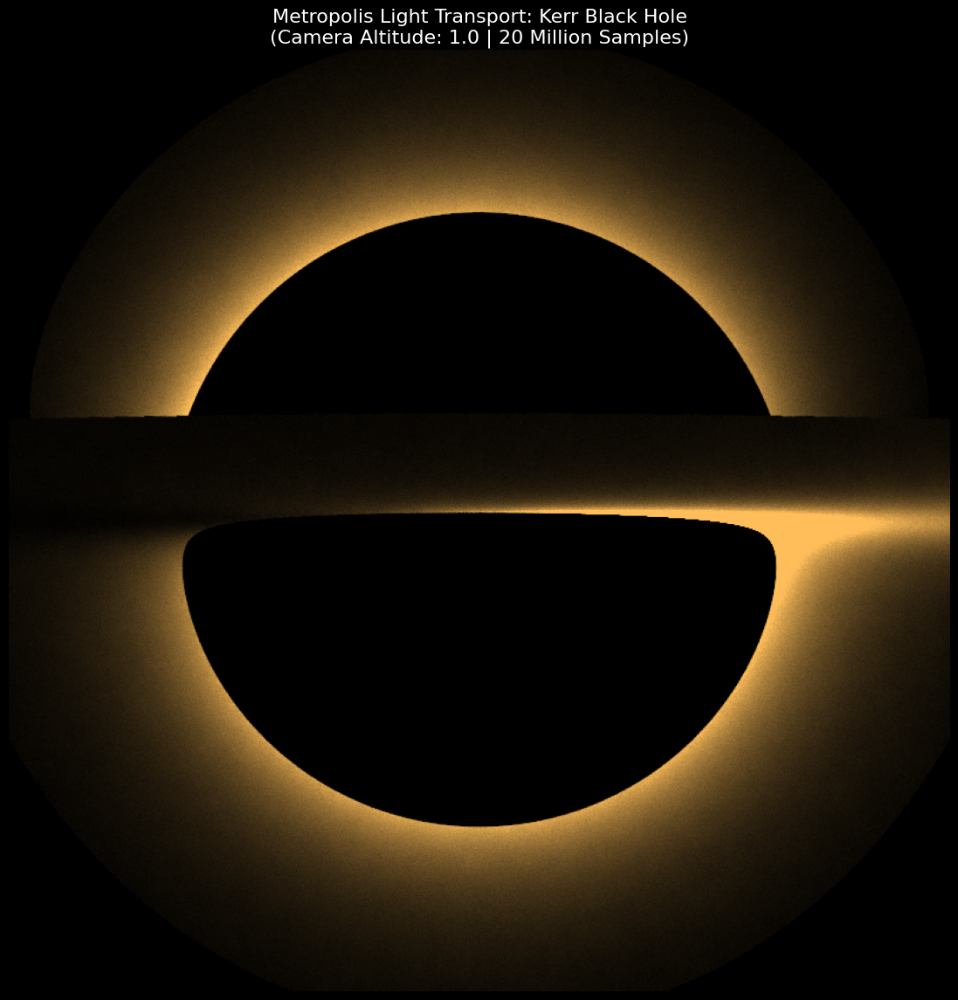


Assembling the Convergence Video...
Convergence Algorithm Visualization:


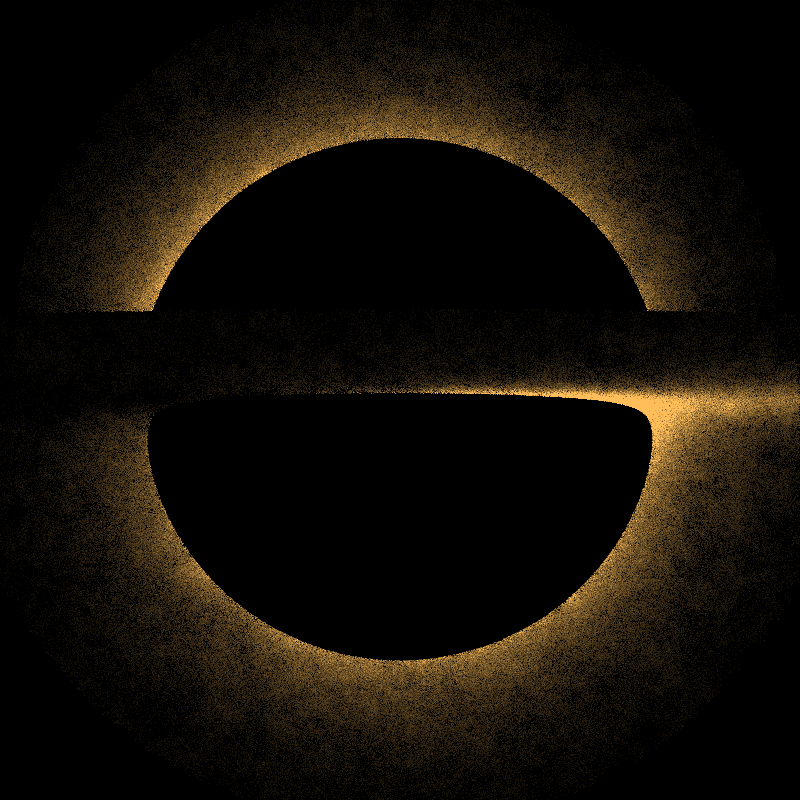

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import subprocess
import os
import glob
import imageio.v2 as imageio
from IPython.display import display, Image

def read_ppm(filename):
    with open(filename, 'r') as f:
        f.readline()
        w, h = map(int, f.readline().split())
        f.readline()
        data = np.fromiter(f.read().split(), dtype=np.uint8)
        return data.reshape((h, w, 3))

#FORCE_RERENDER = True
master_file = "static_master.ppm"
conv_gif_path = "blackhole_convergence.gif"

#if FORCE_RERENDER or not os.path.exists(master_file):
if os.path.exists(master_file):
    print(f"File '{master_file}' found in cache. Skipping C++ render.")
else:
    print("Solving 20 Million Stochastic Geodesics (800x800). Please wait...")
    subprocess.run(["./engine", "static"])
img = read_ppm(master_file)
plt.figure(figsize=(14, 14))
plt.imshow(img)
plt.title("Metropolis Light Transport: Kerr Black Hole\n(Camera Altitude: 1.0 | 20 Million Samples)", color='white', fontsize=16)
plt.axis('off')
fig = plt.gcf()
fig.patch.set_facecolor('black')
plt.show()
print("\nAssembling the Convergence Video...")
frame_files = sorted(glob.glob("conv_*.ppm"))
frames = [read_ppm(file) for file in frame_files]
imageio.mimsave(conv_gif_path, frames, fps=10)

print("Convergence Algorithm Visualization:")
display(Image(filename=conv_gif_path))

File 'blackhole_3D_sweep_HD.gif' found in cache. Skipping C++ render.


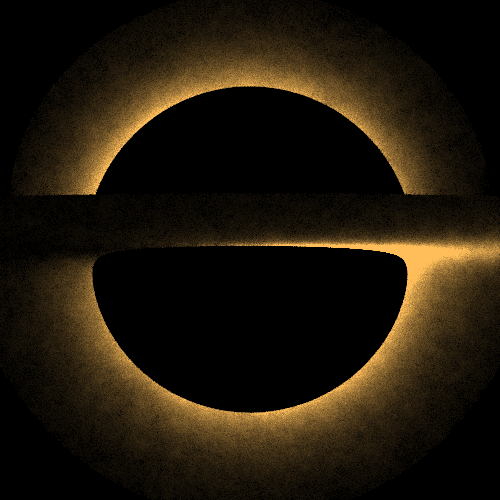

In [ ]:
import imageio.v2 as imageio
import glob
from IPython.display import display, Image
import subprocess
from tqdm.notebook import tqdm
import os

FORCE_RERENDER = True
gif_path = "blackhole_3D_sweep_HD.gif"

if not os.path.exists(gif_path):
    print("Calculating High-Definition 3D Geodesic Trajectories (This will take a few minutes)...")
    process = subprocess.Popen(["./engine", "anim"], stderr=subprocess.PIPE, text=True)
    with tqdm(total=40, desc="Rendering HD Frames") as pbar:
        while True:
            output = process.stderr.readline()
            if output == '' and process.poll() is not None:
                break
            if "Rendered HD Animation Frame" in output:
                pbar.update(1)

    print("Assembling the Volumetric HD GIF...")
    frame_files = sorted(glob.glob("anim_*.ppm"))

    def read_ppm_local(filename):
        with open(filename, 'r') as f:
            f.readline(); w, h = map(int, f.readline().split()); f.readline()
            return np.fromiter(f.read().split(), dtype=np.uint8).reshape((h, w, 3))

    frames = [read_ppm_local(file) for file in frame_files]
    imageio.mimsave(gif_path, frames, fps=12)
    print("HD Animation saved successfully.")
else:
    print(f"File '{gif_path}' found in cache. Skipping C++ render.")

display(Image(filename=gif_path))